### Solving Duffing Equation for Coupled Masses Using Time Integration
If we assume non-linear spring behavior defined by the duffing equation, we can formulate 2 separate equations for both the masses $m_1$ and $m_2$. For the first mass we can write:

$$
m_1\ddot{x}_1 = -\delta_1\dot{x}_1 - \alpha_1x_1 - \beta_1{x_1}^3 + \delta_2(\dot{x}_2-\dot{x}_1) + \alpha_2(x_2 - x_1) + \beta_2(x_2 - x_1)^3
$$

Similarly, for the second mass we can write (assuming the free hanging mass is the only one that is forced)

$$
m_2\ddot{x}_2 = \gamma cos(\omega t) - \delta_2(\dot{x}_2-\dot{x}_1) - \alpha_2(x_2 - x_1) - \beta_2(x_2 - x_1)^3
$$

Let's start by first importing the libraries before we break these equations down

### Import the Libraries

In [6]:
using DifferentialEquations
using Plots
using FFTW
using Statistics

### Breaking Down into First-Order ODEs

To numerically simulate this system, we must convert the second-order ODEs into a system of first-order ODEs by introducing new variables for the positions and velocities of the masses. Let:

$$
x_1 = z_1, \dot{x}_1 = z_2
$$
$$
x_2 = z_3, \dot{x}_2 = z_4
$$

Thus, the second-order derivatives $\ddot{x}_1$ and $\ddot{x}_2$ become $\dot{z}_2$ and $\dot{z}_4$ respectively.

#### First Mass $m_1$:

The equation for the first mass $m_1$ is:

$$
m_1\ddot{x}_1 = -\delta_1\dot{x}_1 - \alpha_1x_1 - \beta_1{x_1}^3 + \delta_2(\dot{x}_2-\dot{x}_1) + \alpha_2(x_2 - x_1) + \beta_2(x_2 - x_1)^3
$$

Substituting the new variables:

$$
m_1 \dot{z}_2 = -\delta_1 z_2 - \alpha_1 z_1 - \beta_1 z_1^3 + \delta_2(z_4 - z_2) + \alpha_2(z_3 - z_1) + \beta_2(z_3 - z_1)^3
$$

#### Second Mass $m_2$:

The equation for the second mass $m_2$ is:

$$
m_2\ddot{x}_2 = \gamma \cos(\omega t) - \delta_2(\dot{x}_2-\dot{x}_1) - \alpha_2(x_2 - x_1) - \beta_2(x_2 - x_1)^3
$$

Substituting the new variables:

$$
m_2 \dot{z}_4 = \gamma \cos(\omega t) - \delta_2(z_4 - z_2) - \alpha_2(z_3 - z_1) - \beta_2(z_3 - z_1)^3
$$

### System of First-Order ODEs

The system of first-order ODEs becomes:

1. $\dot{z}_1 = z_2$
2. $\dot{z}_2 = \frac{-\delta_1 z_2 - \alpha_1 z_1 - \beta_1 z_1^3 + \delta_2(z_4 - z_2) + \alpha_2(z_3 - z_1) + \beta_2(z_3 - z_1)^3}{m_1}$
3. $\dot{z}_3 = z_4$
4. $\dot{z}_4 = \frac{\gamma \cos(\omega t) - \delta_2(z_4 - z_2) - \alpha_2(z_3 - z_1) - \beta_2(z_3 - z_1)^3}{m_2}$


In [26]:
#Define the duffing equation for the system of ODEs
function duffing(du, u, p, t)
    alpha1, alpha2, delta1, delta2, beta1, beta2, gamma, omega, m1, m2 = p
    du[1] = u[2]
    du[2] = (1/m1)*(-delta1*u[2] - alpha1*u[1] - beta1*u[1]^3 + delta2*(u[4] - u[2]) + alpha2*(u[3] - u[1]) + beta2*(u[3] - u[1])^3)
    du[3] = u[4]
    du[4] = (1/m2)*(-delta2*(u[4] - u[2]) - alpha2*(u[3] - u[1]) - beta2*(u[3] - u[1])^3 + gamma*cos(omega*t))
end

#Setting up the parameters for the system
alpha1 = 1.0
alpha2 = 1.0
delta1 = 0.1
delta2 = 0.1
beta1 = 1.0
beta2 = 1.0
gamma = 1
omega = 1
m1 = 1.0
m2 = 1.0

p = [alpha1, alpha2, delta1, delta2, beta1, beta2, gamma, omega, m1, m2]

#Define the initial conditions
u0 = [0.0, 0.0, 0.0, 0.0]

#Define the time span
tspan = (0.0, 200.0)
dt = 0.01

0.01

### Solve the ODEs

In [27]:
#Solve the ODEs
prob = ODEProblem(duffing, u0, tspan, p)
sol1 = solve(prob, ImplicitEuler(), dt=dt) #Implicit Euler method
sol2 = solve(prob, Euler(), dt=dt) #Explicit Euler method

retcode: Success
Interpolation: 3rd order Hermite
t: 20002-element Vector{Float64}:
   0.0
   0.01
   0.02
   0.03
   0.04
   0.05
   0.060000000000000005
   0.07
   0.08
   0.09
   ⋮
 199.92999999996314
 199.93999999996313
 199.94999999996313
 199.95999999996312
 199.9699999999631
 199.9799999999631
 199.9899999999631
 199.99999999996308
 200.0
u: 20002-element Vector{Vector{Float64}}:
 [0.0, 0.0, 0.0, 0.0]
 [0.0, 0.0, 0.0, 0.01]
 [0.0, 1.0e-5, 0.0001, 0.019989500004166653]
 [1.0000000000000001e-7, 3.0969500014166655e-5, 0.00029989500004166654, 0.029966520570818264]
 [4.0969500014166657e-7, 6.387103185482013e-5, 0.0005995602057498492, 0.039929087406967476]
 [1.048405318689868e-6, 0.00010965978750641213, 0.0009988510798195239, 0.04987523174994381]
 [2.145003193753989e-6, 0.00016928325230738953, 0.001497603397318962, 0.0598029907452518]
 [3.837835716827884e-6, 0.00024368084390170985, 0.0020956333047714797, 0.06971040781972528]
 [6.2746441558449825e-6, 0.0003337835578957852, 0.0027927373

### Plotting the Position for the first mass

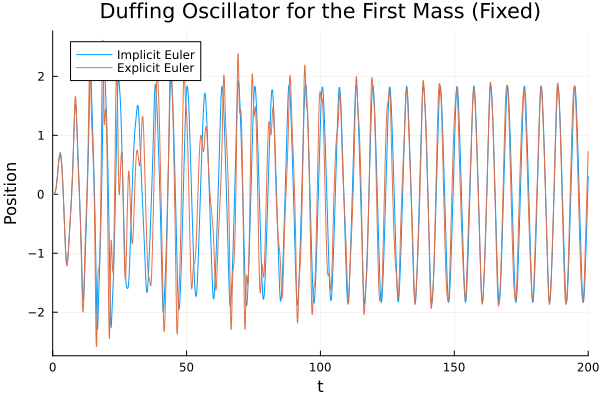

In [28]:
#Plot the position for the first mass
plot(sol1, vars=(0, 1), label="Implicit Euler", xlabel="Time", ylabel="Position", title="Duffing Oscillator for the First Mass (Fixed)")
plot!(sol2, vars=(0, 1), label="Explicit Euler")

### Plotting the Velocity for the first mass

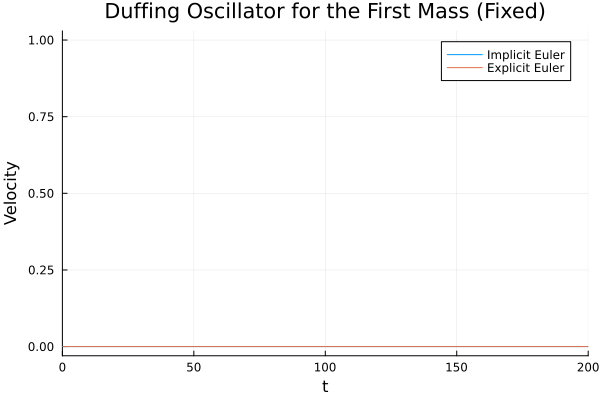

In [23]:
#Plot the velocity of the first mass
plot(sol1, vars=(0, 2), label="Implicit Euler", xlabel="Time", ylabel="Velocity", title="Duffing Oscillator for the First Mass (Fixed)")
plot!(sol2, vars=(0, 2), label="Explicit Euler")

### Plotting the Position for the second mass

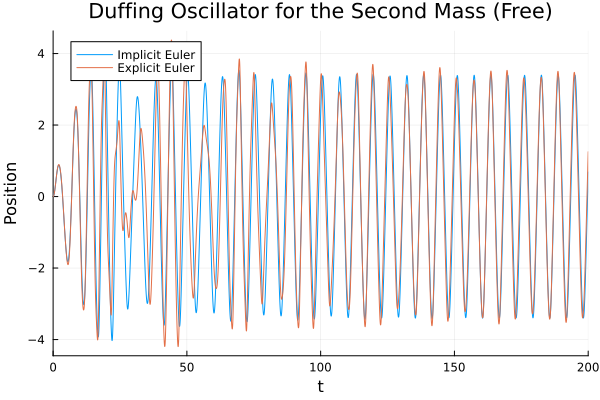

In [29]:
#Plot the position for the second mass
plot(sol1, vars=(0, 3), label="Implicit Euler", xlabel="Time", ylabel="Position", title="Duffing Oscillator for the Second Mass (Free)")
plot!(sol2, vars=(0, 3), label="Explicit Euler")

### Plotting the Velocity for the second mass

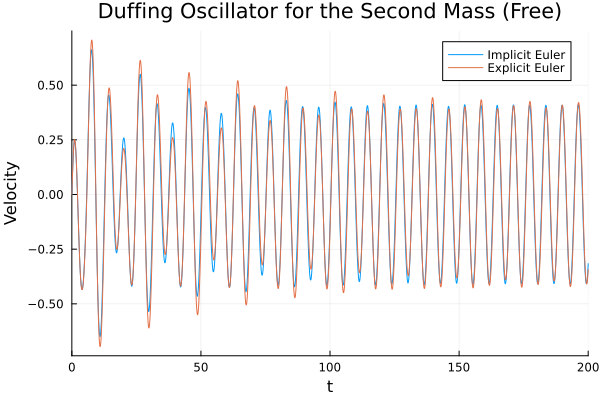

In [5]:
#Plot the velocity of the second mass
plot(sol1, vars=(0, 4), label="Implicit Euler", xlabel="Time", ylabel="Velocity", title="Duffing Oscillator for the Second Mass (Free)")
plot!(sol2, vars=(0, 4), label="Explicit Euler")

### Spectral Analysis of the Time Domain Signal

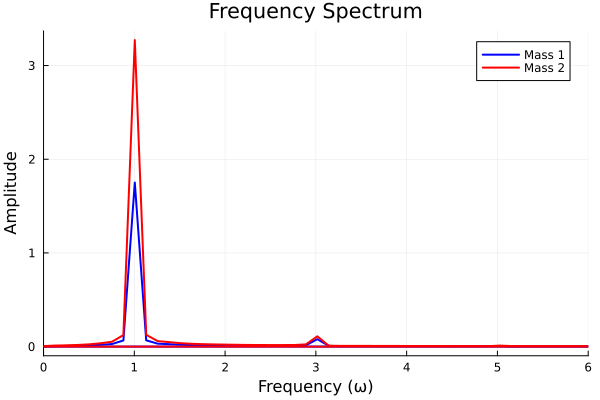

In [31]:
# Sample positions
Nsamples = 2000
Tstart = 150
Tend = 200
dt = (Tend - Tstart)/Nsamples
tsampled = Vector(Tstart:dt:Tend)

# Extract positions
u1_sampled = [sol1(t,idxs=1) for t in tsampled]
u2_sampled = [sol1(t,idxs=3) for t in tsampled]

# Compute FFTs
fft1 = fft(u1_sampled)
fft2 = fft(u2_sampled)

# Create frequency vector  
freq = fftfreq(Nsamples, 1/dt)
ω = 2π * freq
ω = ω[1:div(Nsamples,2)+1]

# Calculate spectra
amp1 = 2/Nsamples * abs.(fft1[1:div(Nsamples,2)+1])
amp2 = 2/Nsamples * abs.(fft2[1:div(Nsamples,2)+1])
amp1[1] = amp1[1]/2
amp2[1] = amp2[1]/2


# Plot with fixed x-axis
p = plot(ω, amp1,
    label="Mass 1",
    xlabel="Frequency (ω)", 
    ylabel="Amplitude",
    title="Frequency Spectrum",
    linewidth=2,
    color=:blue,
    xlims=(0,6)
)

plot!(ω, amp2,
    label="Mass 2",
    linewidth=2,
    color=:red
)

savefig(p, "combined_fft.svg")
display(p)

Angular frequency with maximum amplitude: 1.2147491593880533


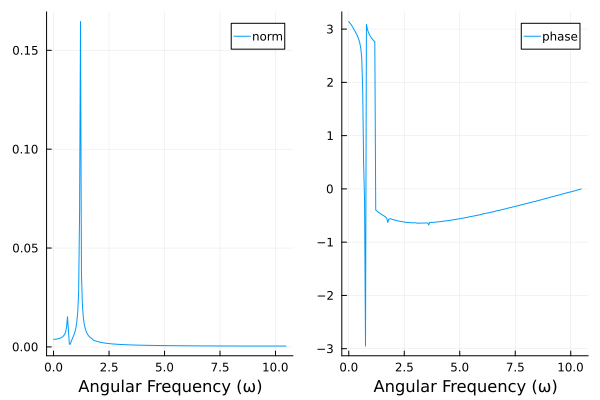

In [29]:
#Retrieve velocity and position at specific sampling points, for the second mass only. We will use the Implicit Euler method.
Nsamples = 500
Tstart = 50
Tend = tspan[2]
dt = (Tend - Tstart)/Nsamples
tsampled = Vector(Tstart:dt:Tend)
vsampled = [sol1(t,idxs=4) for t in tsampled]
usampled = [sol1(t,idxs=3) for t in tsampled]

#Perform the FFT of sampled position data 
uf = fft(usampled);

#Set up the frequency axis
fmax = 1/(2*dt)
fstep = 2*fmax/Nsamples
fvec = Vector(0:fstep:fmax)

#Convert frequency to angular frequency
omega_vec = 2 * π * fvec

#Print the angular frequency with the maximum amplitude
println("Angular frequency with maximum amplitude: ", omega_vec[argmax(abs.(uf[1:length(omega_vec)]))])

#Plot the absolute value of the FFT of the sampled position data
p1 = plot(omega_vec, 2.0/Nsamples * abs.(uf[1:length(omega_vec)]), label="norm", xlabel="Angular Frequency (ω)")
p2 = plot(omega_vec, angle.(uf[1:length(omega_vec)]), label="phase", xlabel="Angular Frequency (ω)")
plot(p1, p2)
